In [1]:
from casacore.tables import table, taql
import numpy as np
import matplotlib.pyplot as plt
from itertools import combinations
from dataclasses import dataclass
from pathlib import Path
import astropy.units as u
from astropy.coordinates import get_sun
from numpy.typing import NDArray
from tqdm import tqdm
from astropy.units import UnitConversionError
from astropy.constants import c as speed_of_light

Successful readonly open of default-locked table /Users/tho822/Documents/scienceData.EMU_1141-55.SB47138.EMU_1141-55.beam30_averaged_cal.leakage.ms/ANTENNA: 8 columns, 36 rows
ants=36, baselines=630


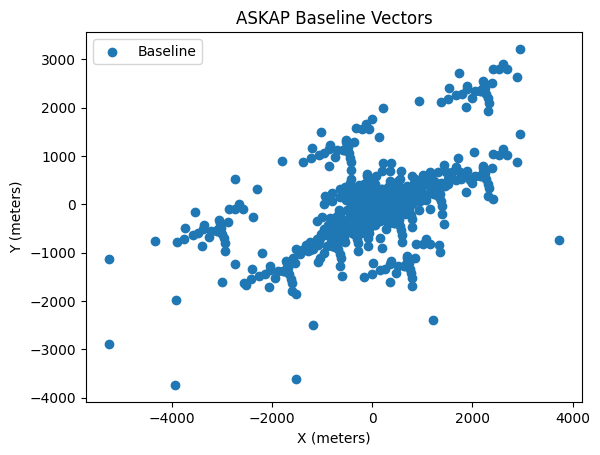

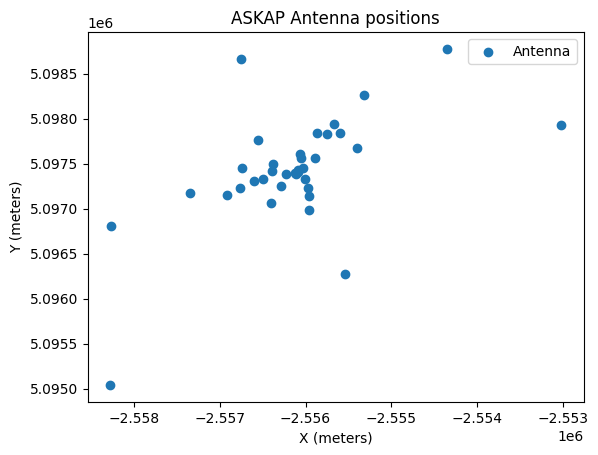

In [2]:
@dataclass
class Baselines:
    ant_xyz: np.ndarray
    b_xyz: np.ndarray
    b_idx: np.ndarray
    b_map: dict[tuple[int,int], int]

def make_baseline_vector(ms_path: Path) -> Baselines:
    with table(str(ms_path / "ANTENNA")) as tab:
        ants_idx = np.arange(len(tab), dtype=int)
        b_idx = np.array(
            list(combinations(list(ants_idx), 2))
        )
        xyz = tab.getcol("POSITION")
        # b_xyz = np.mean((xyz[b_idx[:, 0]], xyz[b_idx[:, 1]]), axis=0)
        b_xyz = (xyz[b_idx[:, 0]] - xyz[b_idx[:, 1]])
    
    b_map = {tuple(k): idx for idx, k in enumerate(b_idx)}
    
    print(f"ants={len(ants_idx)}, baselines={b_idx.shape[0]}")
    return Baselines(
        ant_xyz=xyz*u.m, b_xyz=b_xyz*u.m, b_idx=b_idx, b_map=b_map
    )
    
ms_path = Path(
    "/Users/tho822/Documents/scienceData.EMU_1141-55.SB47138.EMU_1141-55.beam30_averaged_cal.leakage.ms"
)
baselines = make_baseline_vector(ms_path)

fig, ax = plt.subplots(1,1)


ax.scatter(baselines.b_xyz[:, 0], baselines.b_xyz[:, 1], label="Baseline")

ax.set(
    xlabel="X (meters)",
    ylabel="Y (meters)", 
    title="ASKAP Baseline Vectors"
)
ax.legend()


fig, ax = plt.subplots(1,1)

ax.scatter(baselines.ant_xyz[:, 0], baselines.ant_xyz[:, 1], label="Antenna")


ax.set(
    xlabel="X (meters)",
    ylabel="Y (meters)", 
    title="ASKAP Antenna positions"
)
ax.legend()




Successful readonly open of default-locked table /Users/tho822/Documents/scienceData.EMU_1141-55.SB47138.EMU_1141-55.beam30_averaged_cal.leakage.ms/FIELD: 9 columns, 1 rows
Successful readonly open of default-locked table /Users/tho822/Documents/scienceData.EMU_1141-55.SB47138.EMU_1141-55.beam30_averaged_cal.leakage.ms: 24 columns, 2409588 rows
[-53d43m33.3745946s]
[-4h53m22.50265372s -4h53m12.52212164s -4h53m02.54158955s ...
 5h07m57.11933204s 5h08m07.09986399s 5h08m17.0803953s]
[-1.28009 rad -1.27936 rad -1.27864 rad ... 1.34369 rad 1.34442 rad
 1.34515 rad]


<Quantity [30.91032792, 30.93487347, 30.95941998, ..., 28.76394548,
           28.73951481, 28.71508577] deg>

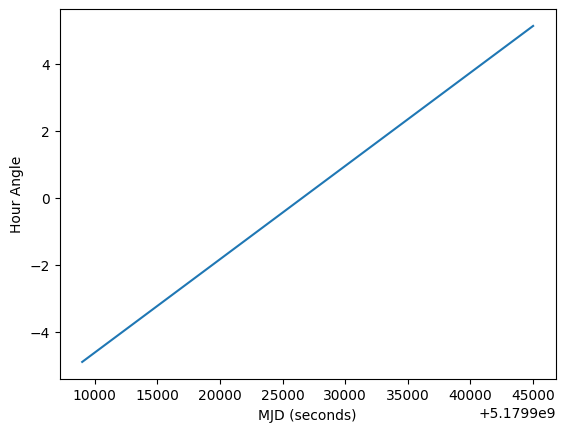

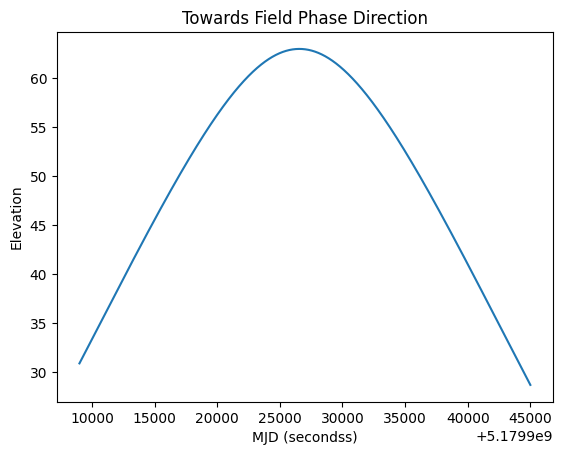

In [3]:

from astropy.time import Time
from astropy.coordinates import EarthLocation, SkyCoord

@dataclass
class HourAngle:
    hour_angle: u.rad
    time_mjds: np.ndarray
    location : EarthLocation
    position: SkyCoord
    elevation: np.ndarray
    time: Time
    time_map: dict[float, int]

ASKAP = EarthLocation(*baselines.ant_xyz.mean(axis=0))
 
def make_hour_angles(
    ms_path: Path, 
    location: EarthLocation = ASKAP, 
    position: SkyCoord | str | None = None,
    whole_day: bool = False
) -> HourAngle:
    if position is None:
        with table(str(ms_path / "FIELD")) as tab:
            field_positions = tab.getcol("PHASE_DIR")
            position = SkyCoord(field_positions[0]*u.rad)
    
    with table(str(ms_path)) as tab:
        times_mjds = tab.getcol("TIME_CENTROID")
        times_mjds, indicies = np.unique(times_mjds, return_index=True)
        sorted_idx = np.argsort(indicies)
        times_mjds = times_mjds[sorted_idx]
        time_map = {k: idx for idx, k in enumerate(times_mjds)}

    if whole_day:
        time_step = times_mjds[1] - times_mjds[0]
        times_mjds = times_mjds[0] + time_step * np.arange(int(60*60*24/time_step))
    
    times = Time(times_mjds/60/60/24, format="mjd")
    
    if position == "sun":
        position = get_sun(times)
    
    lst = times.sidereal_time("apparent", longitude=ASKAP.lon)
    hour_angle = lst - position.ra
    mask = hour_angle > 12 * u.hourangle
    hour_angle[mask] -= 24 * u.hourangle

    print(position.dec)

    sin_alt = (np.arcsin(
        np.sin(ASKAP.lat) * 
        np.sin(position[0].dec.rad) +
        np.cos(ASKAP.lat) *
        np.cos(position.dec.rad) *
        np.cos(hour_angle)
    )).to(u.deg)

    return HourAngle(
        hour_angle=hour_angle, 
        time_mjds=times_mjds, 
        location=location, 
        position=position,
        elevation=sin_alt,
        time=times,
        time_map=time_map
    )

hour_angle = make_hour_angles(ms_path)

fig, ax = plt.subplots(1,1)

ax.plot(hour_angle.time_mjds, hour_angle.hour_angle)
ax.set(
    xlabel="MJD (seconds)",
    ylabel="Hour Angle"
)
print(hour_angle.hour_angle)
print(hour_angle.hour_angle.to(u.rad))

fig, ax = plt.subplots(1,1)

ax.plot(
    hour_angle.time_mjds, hour_angle.elevation
)

ax.set(
    xlabel="MJD (secondss)",
    ylabel="Elevation",
    title="Towards Field Phase Direction"
)
hour_angle.elevation


ouvw.shape=(630, 3, 3618)
ouvw.shape=(3, 630, 3618)
ouvw.shape=(3, 2279340)


/Users/tho822/miniforge3/envs/casacore/lib/python3.12/site-packages/IPython/core/events.py:82: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)
/Users/tho822/miniforge3/envs/casacore/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


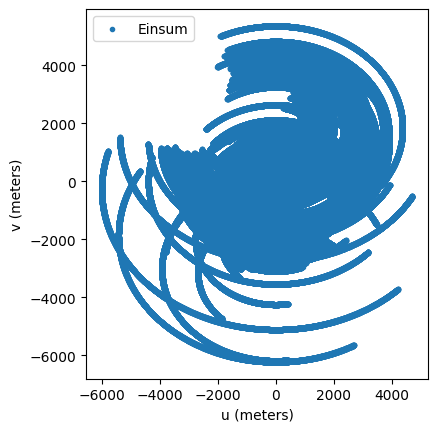

In [4]:
def old_b_xyz_to_uvw(b_xyz: np.ndarray, hour_angle: HourAngle, declination: u.rad):
    ha = hour_angle.hour_angle
    ha = ha.to(u.rad)

    declination = declination.to(u.rad)
    declination = (np.ones(len(ha)) * declination).decompose()
    
    sin_ha = np.sin(ha)
    sin_dec = np.sin(declination)
    cos_ha = np.cos(ha)
    cos_dec = np.cos(declination)
    zeros = np.zeros_like(sin_ha)
    mat = np.array([
        [sin_ha, cos_ha, zeros],
        [-sin_dec * cos_ha, sin_dec*sin_ha, cos_dec],
        [np.cos(declination)*np.cos(ha), np.cos(declination)* np.sin(ha), np.sin(declination)]
    ])
    
    # uvw = np.einsum('ijk,...m->ijm...', mat, b_xyz, optimize=True)
    uvw = np.einsum('ijk,j->ik', mat,b_xyz,  optimize=True)
    
    
    return uvw

def b_xyz_to_uvw(b_xyz: np.ndarray, hour_angle: HourAngle, declination: u.rad):
    hour_angles_rad = hour_angle.hour_angle.to(u.rad)
    uvws = []
    declination = declination.to(u.rad)[0]
    for hour_angle_rad in hour_angles_rad:
        ha = hour_angle_rad
        
        sin_ha = np.sin(ha)
        sin_dec = np.sin(declination)
        cos_ha = np.cos(ha)
        cos_dec = np.cos(declination)
        zeros = np.zeros_like(sin_ha)
        
        mat = np.array([
            [sin_ha, cos_ha, 0],
            [-sin_dec * cos_ha, sin_dec*sin_ha, cos_dec],
            [np.cos(declination)*np.cos(ha), np.cos(declination)* np.sin(ha), np.sin(declination)]
        ])
    
        uvw = mat @ b_xyz
        # uvw = np.matmul(mat, b_xyz)
        uvws.append(uvw)
    
    
    print(b_xyz)
    return np.array(uvws)

fig, ax = plt.subplots(1,1)

all_uvws = []
for idx, b_xyz in enumerate(baselines.b_xyz):
    # ouvw = b_xyz_to_uvw(b_xyz=b_xyz, hour_angle=hour_angle, declination=hour_angle.position.dec)
    ouvw = old_b_xyz_to_uvw(b_xyz, hour_angle=hour_angle, declination=hour_angle.position.dec)
    all_uvws.append(ouvw)


ouvw = np.array(all_uvws)
print(f"{ouvw.shape=}")
ouvw = np.swapaxes(ouvw, 0, 1)
print(f"{ouvw.shape=}")
ouvw = ouvw.reshape((3, -1))
print(f"{ouvw.shape=}")

ax.scatter(
    ouvw[0, :], ouvw[1, :], 
    marker='.', 
    label="Einsum", 
    # color="blue"
)
ax.set(
    xlabel = "u (meters)",
    ylabel="v (meters)",
    aspect="equal",
)
ax.legend()


ouvw.shape=(630, 3, 3618)
Finished
time_mask.shape=(2279340,)
ouvw.shape=(3, 2279340)


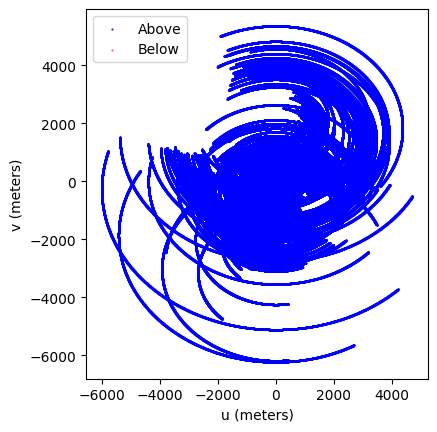

In [5]:
def all_b_xyz_to_uvw(b_xyz: np.ndarray, hour_angle: HourAngle, declination: u.rad):
    ha = hour_angle.hour_angle
    ha = ha.to(u.rad)

    declination = declination.to(u.rad)
    declination = (np.ones(len(ha)) * declination).decompose()
    
    sin_ha = np.sin(ha)
    sin_dec = np.sin(declination)
    cos_ha = np.cos(ha)
    cos_dec = np.cos(declination)
    zeros = np.zeros_like(sin_ha)
    mat = np.array([
        [sin_ha, cos_ha, zeros],
        [-sin_dec * cos_ha, sin_dec*sin_ha, cos_dec],
        [np.cos(declination)*np.cos(ha), np.cos(declination)* np.sin(ha), np.sin(declination)]
    ])
    
    uvw = np.einsum('ijk,lj->lik', mat, b_xyz,  optimize=True)
    
    
    return uvw


no_baselines = baselines.b_xyz.shape[0]
ouvw = all_b_xyz_to_uvw(b_xyz=baselines.b_xyz[:no_baselines], hour_angle=hour_angle, declination=hour_angle.position.dec)
print(f"{ouvw.shape=}")
ouvw = np.swapaxes(ouvw, 0, 1).reshape((3, -1))
print("Finished")

time_mask = hour_angle.elevation < 10*u.deg
time_mask = np.array(
    [time_mask for _ in range(no_baselines)]
).reshape(-1)
# time_mask = np.repeat(time_mask, baselines.b_idx.shape[0])

print(f"{time_mask.shape=}")
print(f"{ouvw.shape=}")

fig, ax = plt.subplots(1,1)

ax.scatter(
    ouvw[0, ~time_mask], ouvw[1, ~time_mask], marker='.', s=1, label="Above", color="blue"
)

ax.scatter(
    ouvw[0, time_mask], ouvw[1, time_mask], marker='.', s=0.5, label="Below", color="red"
)

ax.set(
    xlabel = "u (meters)",
    ylabel="v (meters)",
    aspect="equal",
)
ax.legend()



Successful readonly open of default-locked table /Users/tho822/Documents/scienceData.EMU_1141-55.SB47138.EMU_1141-55.beam30_averaged_cal.leakage.ms: 24 columns, 2409588 rows
[-22d15m27.79063968s -22d15m27.73525791s -22d15m27.6798758s ...
 -22d12m05.31787671s -22d12m05.26124076s -22d12m05.20460446s]
len(sun_hour_angles.position.dec)=3618
uv_length=<Quantity [  24.86534978,   24.88669184,   24.90802573, ..., 2997.36982382,
           2997.4156289 , 2997.46161266] m>


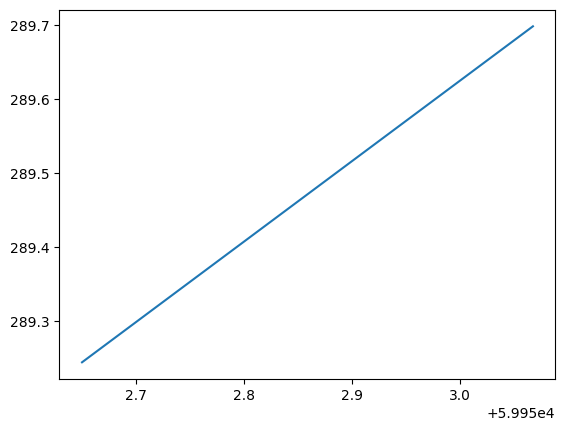

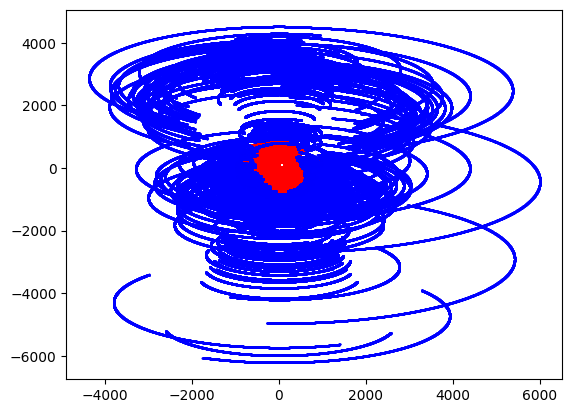

In [6]:
from astropy.coordinates import get_sun

sun_hour_angles = make_hour_angles(
    ms_path=ms_path, position="sun"
)
sun = sun_hour_angles.position

sun_uvws = all_b_xyz_to_uvw(
    b_xyz=baselines.b_xyz, hour_angle=sun_hour_angles, declination=sun_hour_angles.position.dec
)
print(f"{len(sun_hour_angles.position.dec)=}")
fig, ax = plt.subplots(1, 1)

ax.plot(
    hour_angle.time.mjd, sun.ra
)

sun_uvws = np.swapaxes(sun_uvws, 0, 1)
sun_shape = sun_uvws.shape
sun_uvws = sun_uvws.reshape((3, -1))

uv_length = (sun_uvws[0]**2 + sun_uvws[1]**2+ sun_uvws[2]**2)**0.5
print(f"{uv_length=}")
short = uv_length < 1000*u.m

fig, ax = plt.subplots(1, 1)

ax.scatter(
    sun_uvws[0, short], sun_uvws[1, short], marker='.', s=1, color="red", label="Short"
)
ax.scatter(
    sun_uvws[0, ~short], sun_uvws[1, ~short], marker='.', s=1, color="blue", label="long"
)




<>:26: SyntaxWarning: invalid escape sequence '\_'
<>:27: SyntaxWarning: invalid escape sequence '\_'
<>:33: SyntaxWarning: invalid escape sequence '\_'
<>:34: SyntaxWarning: invalid escape sequence '\_'
<>:51: SyntaxWarning: invalid escape sequence '\_'
<>:52: SyntaxWarning: invalid escape sequence '\_'
<>:58: SyntaxWarning: invalid escape sequence '\_'
<>:59: SyntaxWarning: invalid escape sequence '\_'
<>:26: SyntaxWarning: invalid escape sequence '\_'
<>:27: SyntaxWarning: invalid escape sequence '\_'
<>:33: SyntaxWarning: invalid escape sequence '\_'
<>:34: SyntaxWarning: invalid escape sequence '\_'
<>:51: SyntaxWarning: invalid escape sequence '\_'
<>:52: SyntaxWarning: invalid escape sequence '\_'
<>:58: SyntaxWarning: invalid escape sequence '\_'
<>:59: SyntaxWarning: invalid escape sequence '\_'
/var/folders/ss/mnyzscb57dv563q7fhpcnvmh00p7kq/T/ipykernel_21649/3691474191.py:26: SyntaxWarning: invalid escape sequence '\_'
  xlabel="$u_{PHASE\_DIR}$ (meters)",
/var/folders/ss/mny

0.36014811305026895


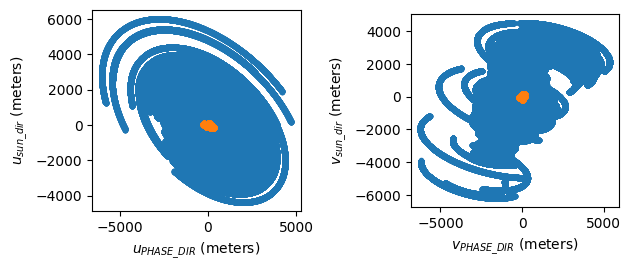

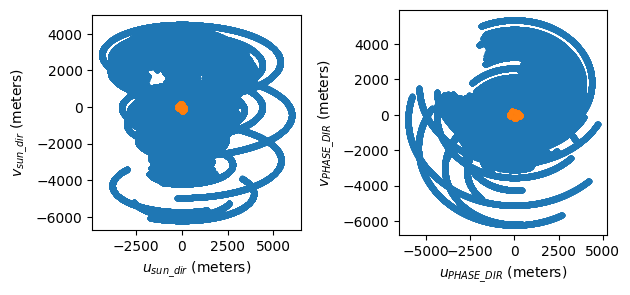

In [7]:
fig, (ax1, ax2) = plt.subplots(1,2)

diff_uvw = (sun_uvws - ouvw)

uv_dist = (ouvw[0]**2 + ouvw[1]**2 + ouvw[2]**2)**0.5
sun_uv_dist = (sun_uvws[0]**2 + sun_uvws[1]**2 + sun_uvws[2]**2 )**0.5

LIMIT = 200 * u.m
uv_short = uv_dist < LIMIT
sun_uv_short = sun_uv_dist < LIMIT

diff_short = (uv_short == False) & (sun_uv_short)
# diff_short = uv_short != sun_uv_short

changed_perc = np.sum(diff_short) / len(diff_short) * 100.
print(changed_perc)

ax1.scatter(ouvw[0, ~diff_short], sun_uvws[0, ~diff_short], marker='.', label="Unchanged")
ax1.scatter(ouvw[0, diff_short], sun_uvws[0, diff_short], marker='.', label="Changed to flagged")

ax2.scatter(ouvw[1, ~diff_short], sun_uvws[1, ~diff_short], marker='.', label="Unchanged")
ax2.scatter(ouvw[1, diff_short], sun_uvws[1, diff_short], marker='.', label="Changed to flagged")


ax1.set(
    xlabel="$u_{PHASE\_DIR}$ (meters)",
    ylabel="$u_{sun\_dir}$ (meters)",
    aspect="equal",
    
)

ax2.set(
    xlabel="$v_{PHASE\_DIR}$ (meters)",
    ylabel="$v_{sun\_dir}$ (meters)",
    aspect="equal",
    
)
fig.tight_layout()


fig, (ax1, ax2) = plt.subplots(1,2)

ax1.scatter(sun_uvws[0, ~diff_short], sun_uvws[1, ~diff_short], marker='.', label="Unchanged")
ax1.scatter(sun_uvws[0, diff_short], sun_uvws[1, diff_short], marker='.', label="Changed to flagged")

ax2.scatter(ouvw[0, ~diff_short], ouvw[1, ~diff_short], marker='.', label="Unchanged")
ax2.scatter(ouvw[0, diff_short], ouvw[1, diff_short], marker='.', label="Changed to flagged")


ax1.set(
    xlabel="$u_{sun\_dir}$ (meters)",
    ylabel="$v_{sun\_dir}$ (meters)",
    aspect="equal",
    
)

ax2.set(
    xlabel="$u_{PHASE\_DIR}$ (meters)",
    ylabel="$v_{PHASE\_DIR}$ (meters)",
    aspect="equal",
    
)
fig.tight_layout()





In [8]:
@dataclass
class SunScale():
    sun_scale_chan_lambda: u.Quantity
    chan_lambda: u.Quantity

def get_sun_scale_uvdist(ms_path: Path) -> SunScale:
    with table(str(ms_path / "SPECTRAL_WINDOW")) as tab:
        chan_freqs = tab.getcol("CHAN_FREQ")[0] * u.Hz
    
    chan_lambda_m = np.squeeze((speed_of_light / chan_freqs).to(u.m))

    sun_diameter = 0.075 * u.deg
    sun_scale_chan_lambda = (chan_lambda_m / sun_diameter.to(u.rad).value)

    return SunScale(
        sun_scale_chan_lambda=sun_scale_chan_lambda,
        chan_lambda=chan_lambda_m
    )


_sun = get_sun_scale_uvdist(ms_path=ms_path)

print(_sun.sun_scale_chan_lambda)



Successful readonly open of default-locked table /Users/tho822/Documents/scienceData.EMU_1141-55.SB47138.EMU_1141-55.beam30_averaged_cal.leakage.ms/SPECTRAL_WINDOW: 14 columns, 1 rows
[286.28402303 285.92661063 285.57008954 285.21445644 284.859708
 284.50584094 284.15285197 283.80073783 283.44949527 283.09912105
 282.74961197 282.40096482 282.05317641 281.70624358 281.36016318
 281.01493207 280.67054711 280.32700522 279.98430329 279.64243825
 279.30140703 278.9612066  278.62183391 278.28328595 277.94555972
 277.60865223 277.27256051 276.93728159 276.60281254 276.26915041
 275.9362923  275.6042353  275.27297652 274.94251309 274.61284215
 274.28396085 273.95586635 273.62855584 273.30202651 272.97627557
 272.65130023 272.32709773 272.00366532 271.68100025 271.3590998
 271.03796125 270.7175819  270.39795907 270.07909007 269.76097224
 269.44360293 269.12697951 268.81109934 268.49595981 268.18155832
 267.86789228 267.55495912 267.24275626 266.93128115 266.62053126
 266.31050405 266.001197   

In [65]:
with table(str(ms_path), readonly=True) as tab:
    ant_idx = np.unique(tab.getcol("ANTENNA1"))
    for ant_1 in ant_idx:
        for ant_2 in ant_idx:
            if ant_1 == ant_2:
                continue
            with taql(
                "select from $tab where ANTENNA1 == $ant_1 and ANTENNA2 == $ant_2",
            ) as subtab:
                if subtab.nrows() == 0:
                    continue
                print(f"ant1={ant_1}, ant2={ant_2}, rows={subtab.nrows()}")
                # Do something with the subtable
                # For example, you could read a column or perform some analysis
                # data = subtab.getcol("DATA")
                # print(data)
                data = subtab.getcol("DATA")[:]
                time = subtab.getcol("TIME_CENTROID")[:]
                flags = subtab.getcol("FLAG")[:]
                # break
            break
        break

Successful readonly open of default-locked table /Users/tho822/Documents/scienceData.EMU_1141-55.SB47138.EMU_1141-55.beam30_averaged_cal.leakage.ms: 24 columns, 2409588 rows
ant1=0, ant2=1, rows=3618


Successful readonly open of default-locked table /Users/tho822/Documents/scienceData.EMU_1141-55.SB47138.EMU_1141-55.beam30_averaged_cal.leakage.ms: 24 columns, 2409588 rows
ant1=1, ant2=2, rows=3618
Successful readonly open of default-locked table /Users/tho822/Documents/scienceData.EMU_1141-55.SB47138.EMU_1141-55.beam30_averaged_cal.leakage.ms/SPECTRAL_WINDOW: 14 columns, 1 rows
Successful readonly open of default-locked table /Users/tho822/Documents/scienceData.EMU_1141-55.SB47138.EMU_1141-55.beam30_averaged_cal.leakage.ms: 24 columns, 2409588 rows
ant1=1, ant2=3, rows=3618
Successful readonly open of default-locked table /Users/tho822/Documents/scienceData.EMU_1141-55.SB47138.EMU_1141-55.beam30_averaged_cal.leakage.ms/SPECTRAL_WINDOW: 14 columns, 1 rows
Successful readonly open of default-locked table /Users/tho822/Documents/scienceData.EMU_1141-55.SB47138.EMU_1141-55.beam30_averaged_cal.leakage.ms: 24 columns, 2409588 rows
ant1=1, ant2=4, rows=3618
Successful readonly open of defa

/var/folders/ss/mnyzscb57dv563q7fhpcnvmh00p7kq/T/ipykernel_21649/1798203369.py:33: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(3, 1, figsize=(10, 10), sharex=True)


Successful readonly open of default-locked table /Users/tho822/Documents/scienceData.EMU_1141-55.SB47138.EMU_1141-55.beam30_averaged_cal.leakage.ms: 24 columns, 2409588 rows
ant1=1, ant2=23, rows=3618
Successful readonly open of default-locked table /Users/tho822/Documents/scienceData.EMU_1141-55.SB47138.EMU_1141-55.beam30_averaged_cal.leakage.ms/SPECTRAL_WINDOW: 14 columns, 1 rows
Successful readonly open of default-locked table /Users/tho822/Documents/scienceData.EMU_1141-55.SB47138.EMU_1141-55.beam30_averaged_cal.leakage.ms: 24 columns, 2409588 rows
ant1=1, ant2=24, rows=3618
Successful readonly open of default-locked table /Users/tho822/Documents/scienceData.EMU_1141-55.SB47138.EMU_1141-55.beam30_averaged_cal.leakage.ms/SPECTRAL_WINDOW: 14 columns, 1 rows
Successful readonly open of default-locked table /Users/tho822/Documents/scienceData.EMU_1141-55.SB47138.EMU_1141-55.beam30_averaged_cal.leakage.ms: 24 columns, 2409588 rows
ant1=1, ant2=25, rows=3618
Successful readonly open of d

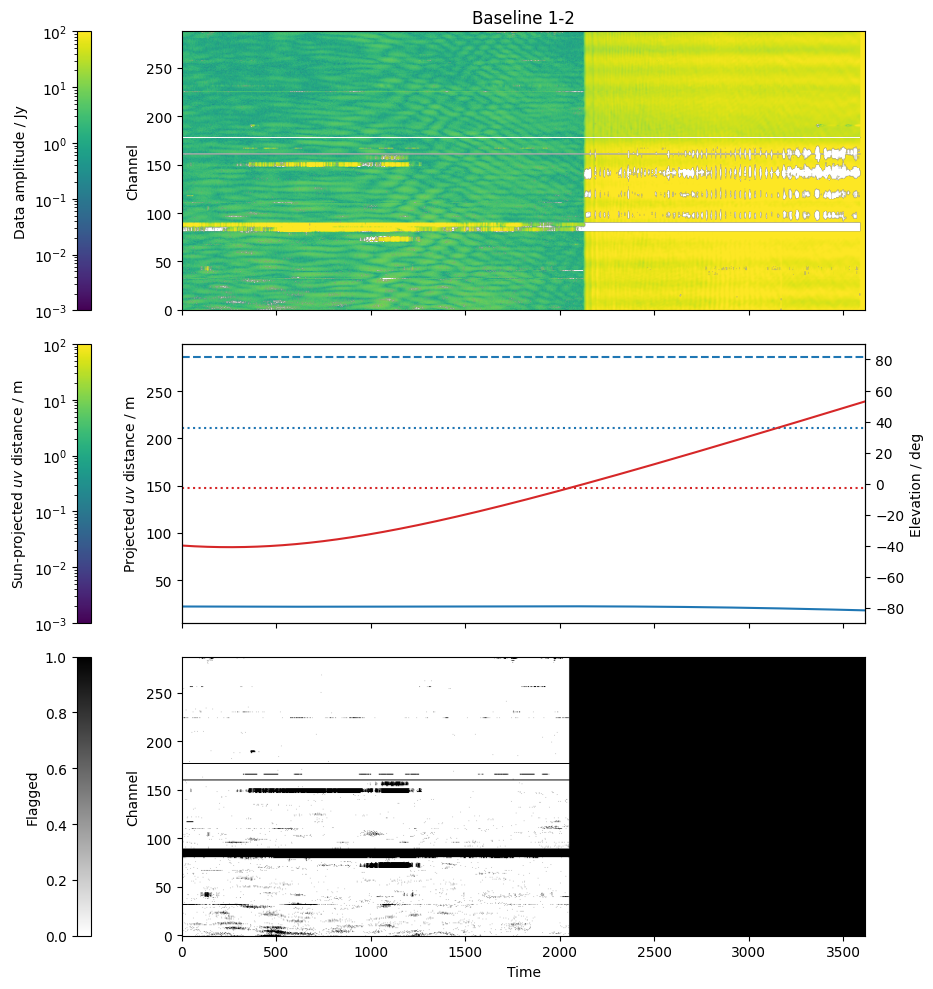

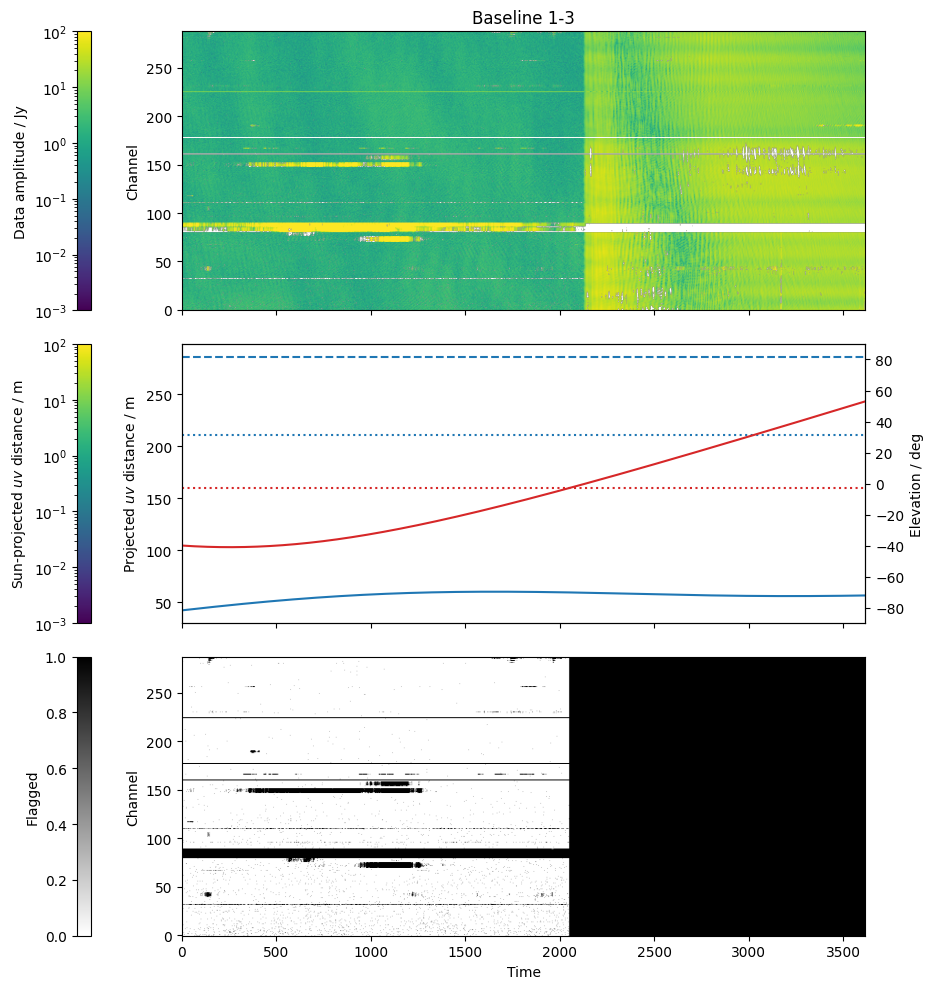

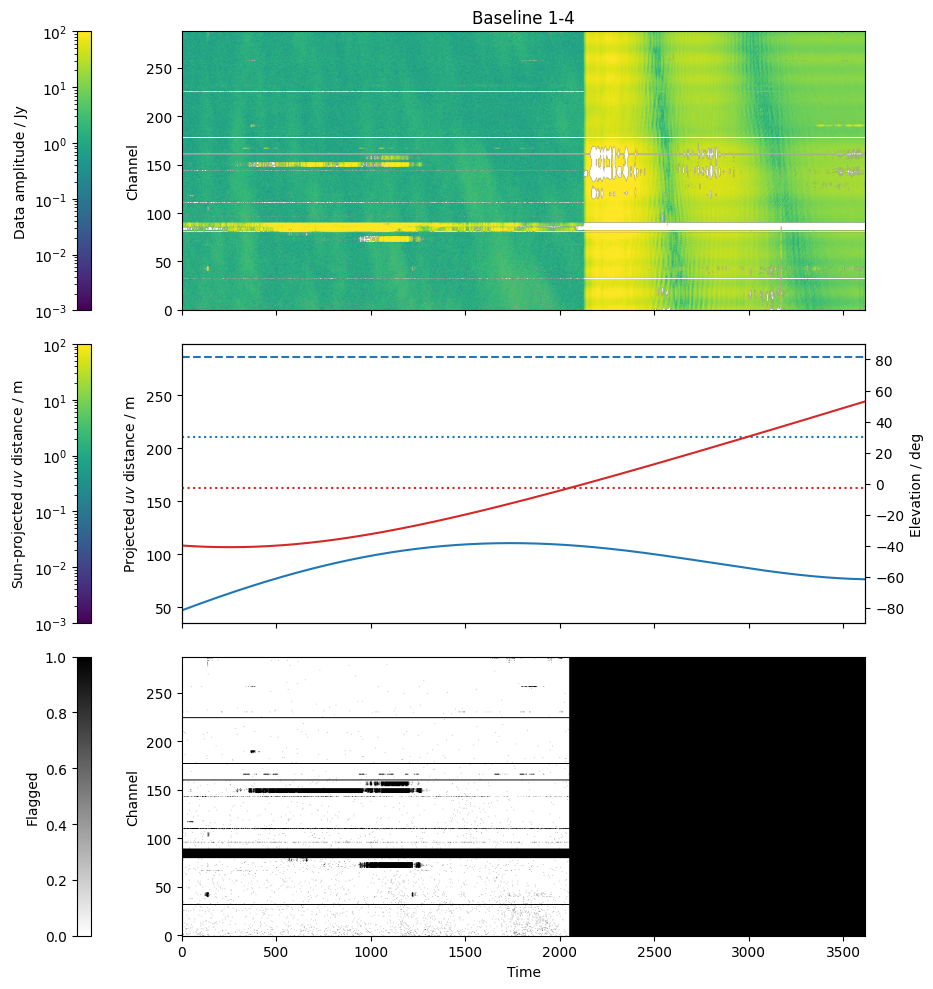

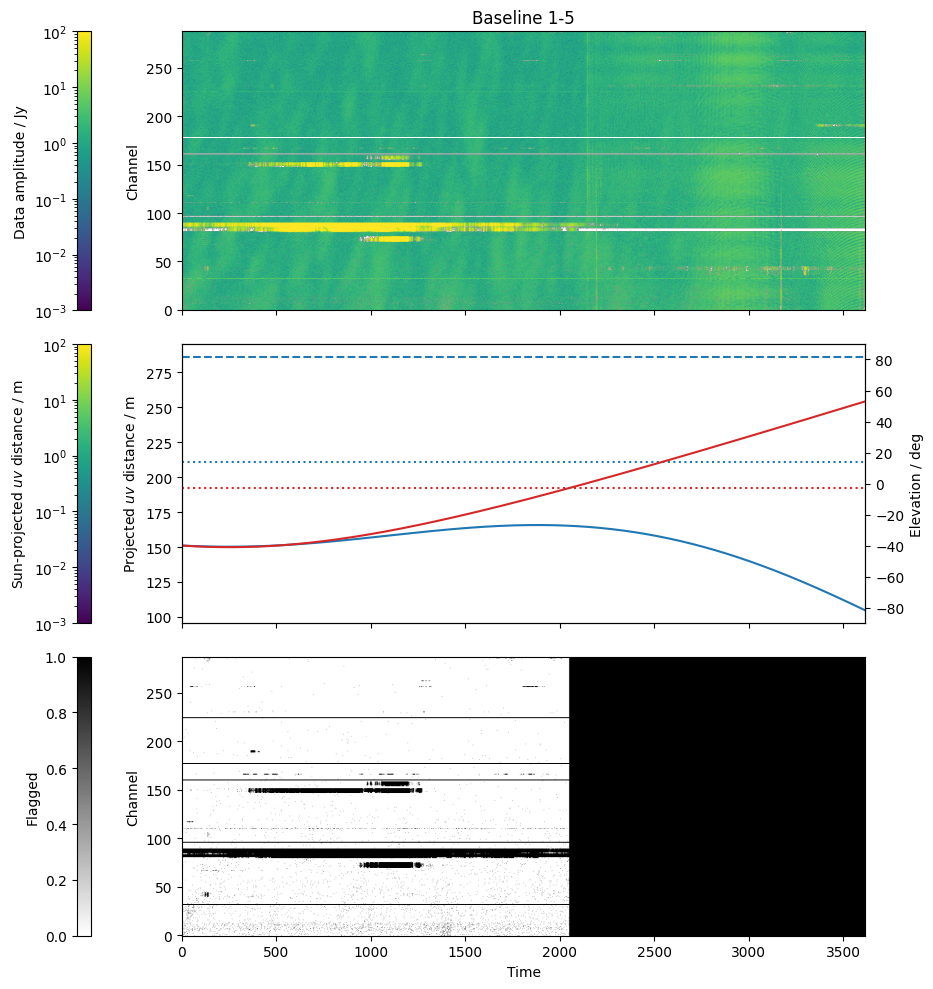

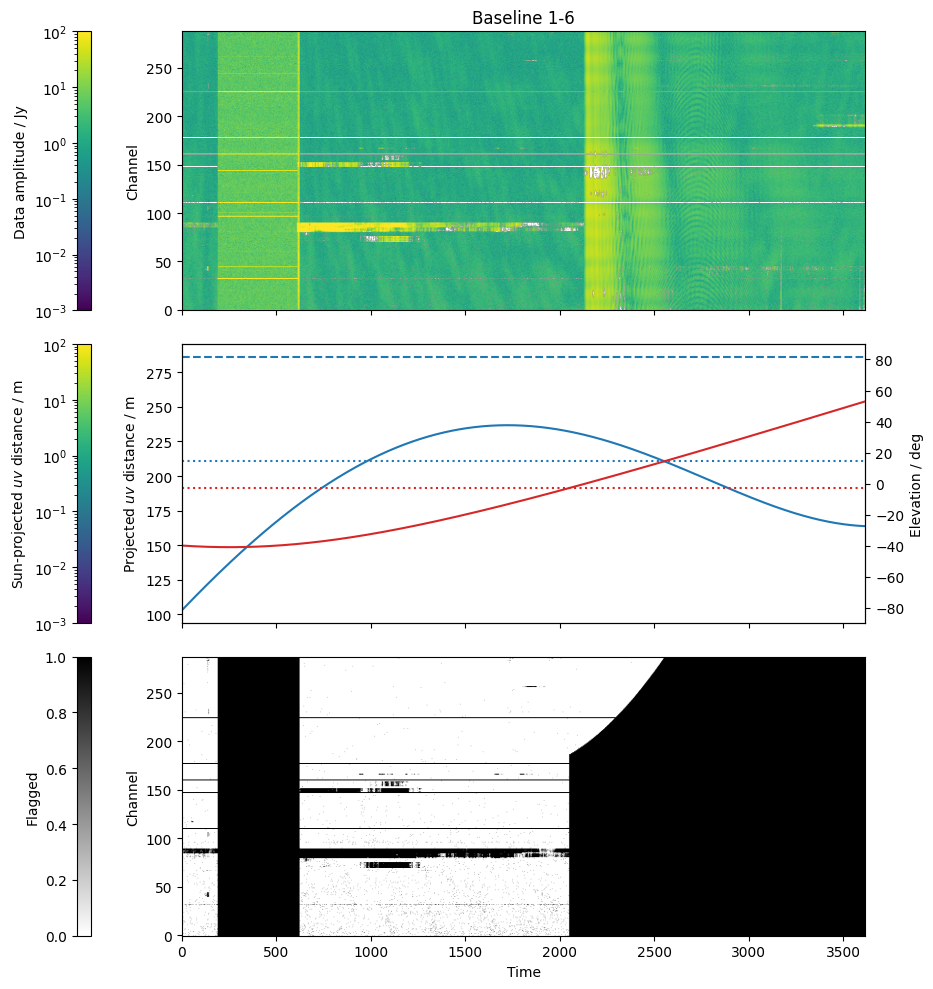

...

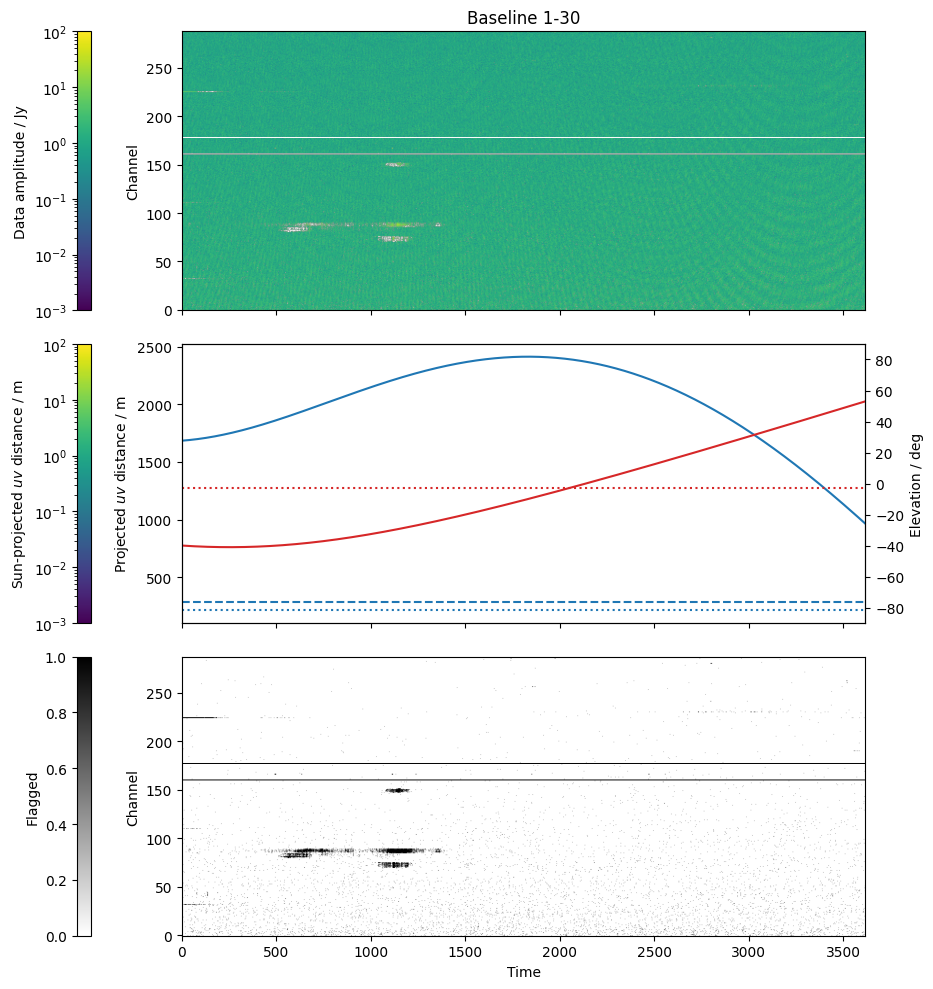

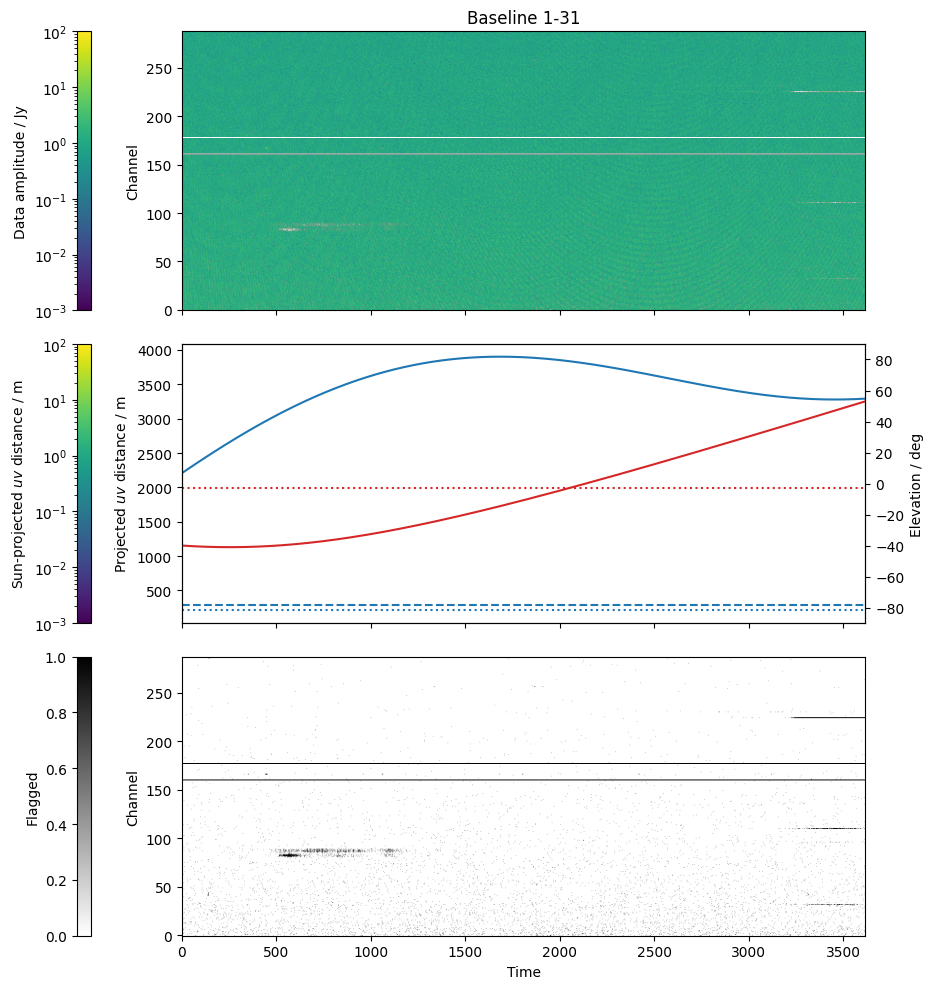

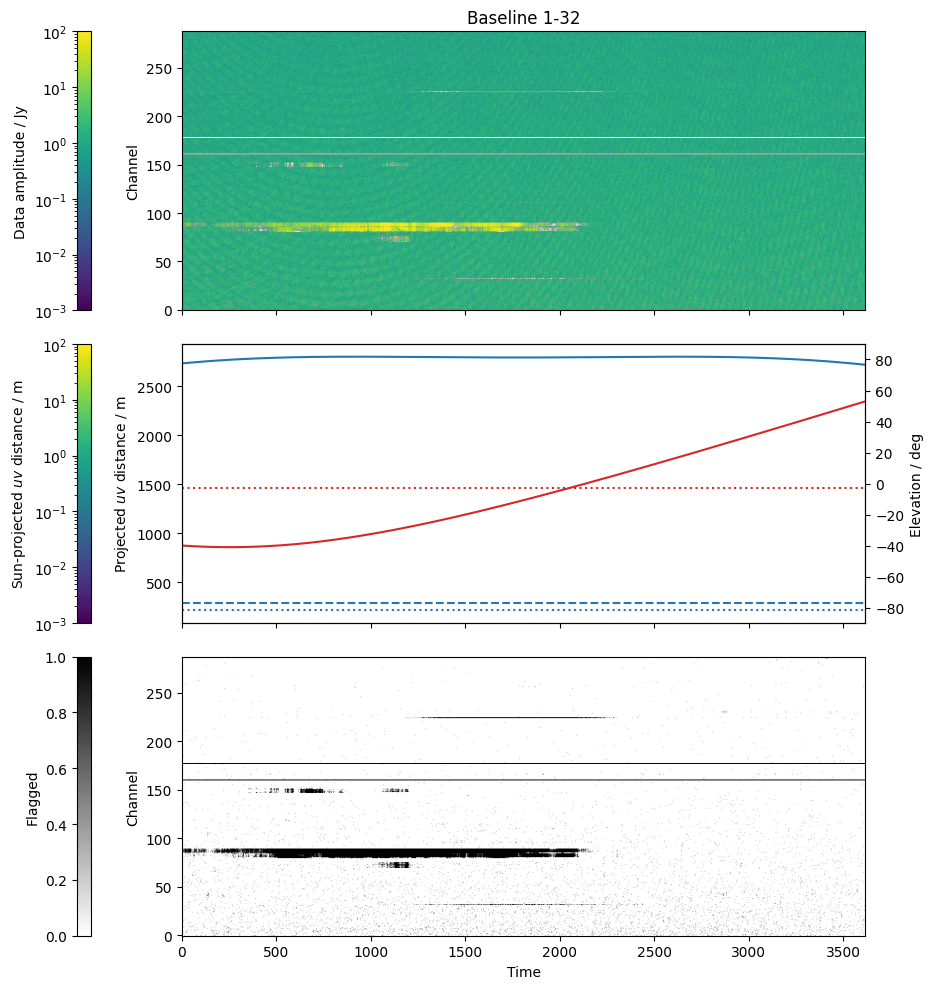

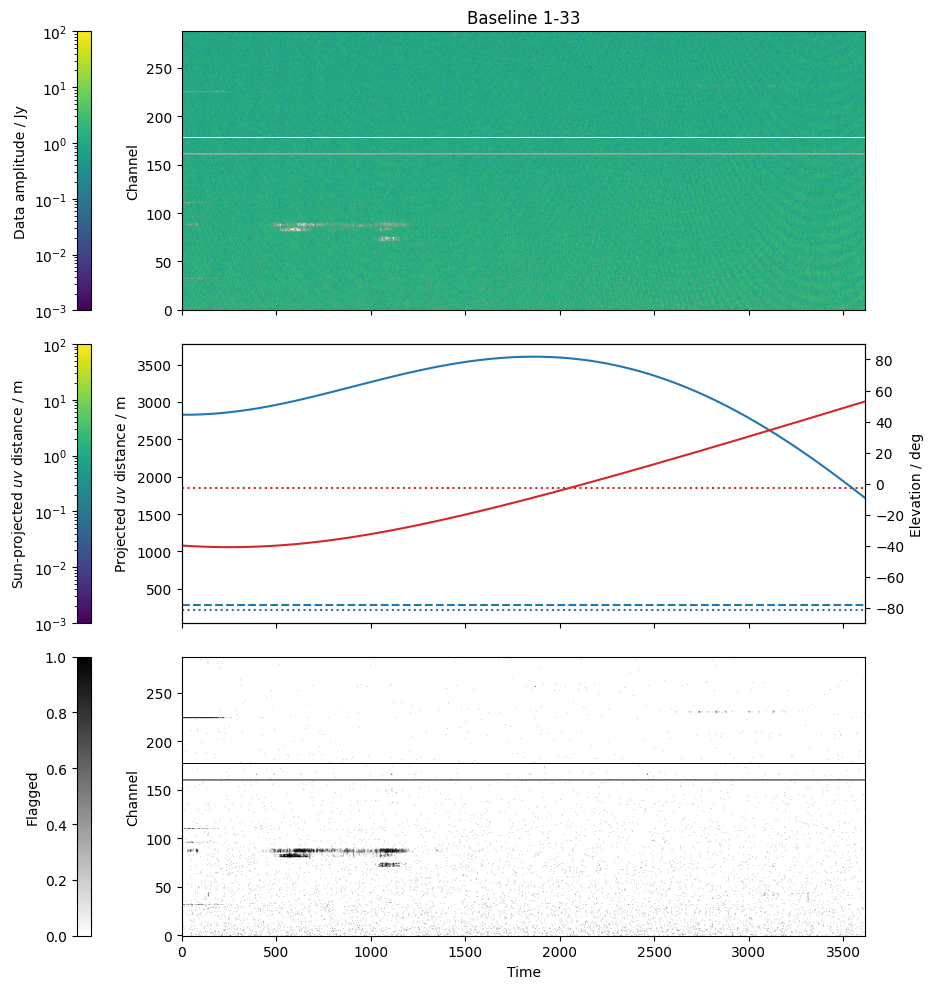

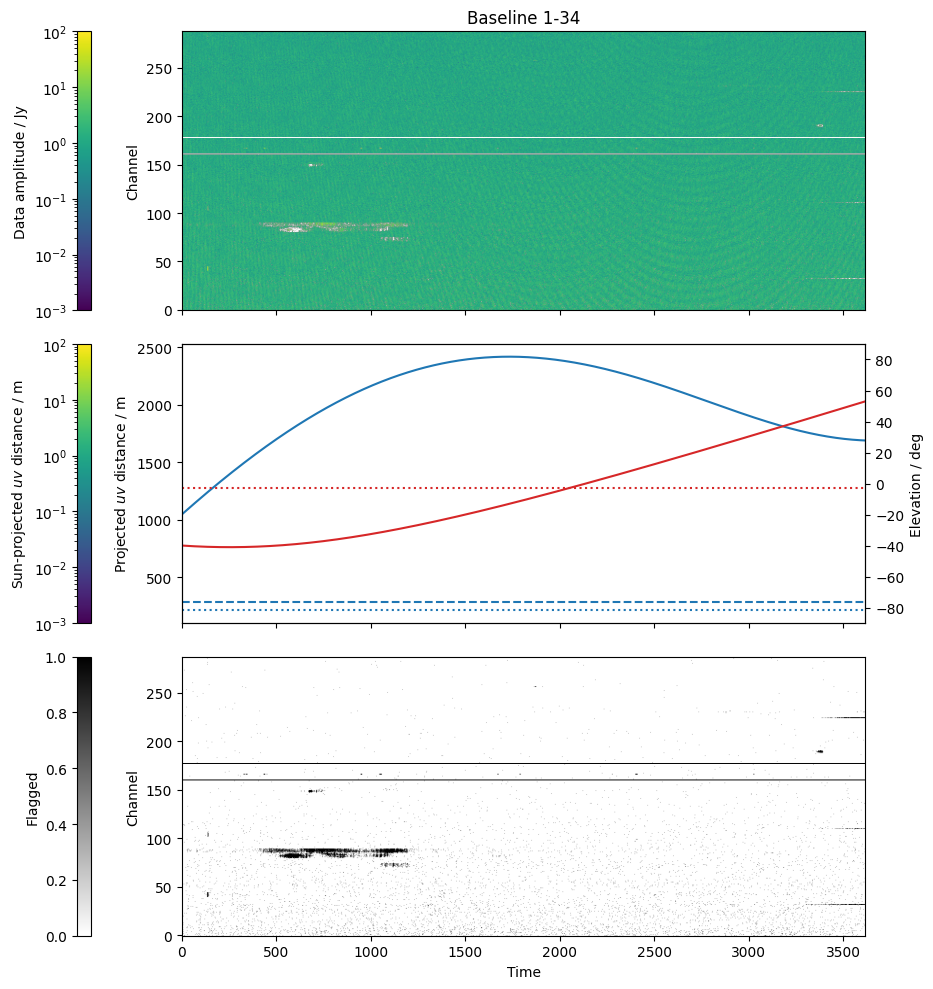

In [119]:
ant_1 = 1
for ant_2 in range(2, 35):
    with table(str(ms_path), readonly=True) as tab:
        ant_idx = np.unique(tab.getcol("ANTENNA1"))
        with taql(
            "select from $tab where ANTENNA1 == $ant_1 and ANTENNA2 == $ant_2",
        ) as subtab:
            print(f"ant1={ant_1}, ant2={ant_2}, rows={subtab.nrows()}")
            # Do something with the subtable
            # For example, you could read a column or perform some analysis
            # data = subtab.getcol("DATA")
            # print(data)
            data = subtab.getcol("DATA")[:]
            time = subtab.getcol("TIME_CENTROID")[:]
            flags = subtab.getcol("FLAG")[:]

    #################
    sun_scale = get_sun_scale_uvdist(ms_path=ms_path)
    horizon_lim = -3 * u.deg
    b_idx = baselines.b_map[(ant_1, ant_2)]
    uvws = sun_uvws.reshape(sun_shape)
    uvws_bt = uvws[:, b_idx]  # / sun_scale.chan_lambda
    uv_dist = np.sqrt((uvws_bt[0]) ** 2 + (uvws_bt[1]) ** 2).to(u.m).value
    flag_uv_dist = (
        uv_dist[:, None] < sun_scale.sun_scale_chan_lambda.to(u.m).value[None, :]
    ) & (sun_hour_angles.elevation > horizon_lim)[:, None]
    total_flags = np.logical_or(flags, flag_uv_dist[..., None])


    #################
    data_xx, data_xy, data_xy, data_yy = data.T
    data_i = np.abs(data_xx + data_yy)
    fig, axs = plt.subplots(3, 1, figsize=(10, 10), sharex=True)
    ax1, ax2, ax3 = axs.flatten()
    im = ax1.imshow(data_i, origin="lower", aspect="auto", norm=plt.cm.colors.LogNorm(vmin=1e-3, vmax=1e2))
    fig.colorbar(im, ax=ax1, label="Data amplitude / Jy", location="left")
    # im = ax2.imshow(
    #     uv_dist.T, origin="lower", aspect="auto"
    # )
    ax2.plot(
        uv_dist,
    )
    ax2.axhline(
        sun_scale.sun_scale_chan_lambda.to(u.m).value.min(),
        color="tab:blue",
        linestyle=":",
    )
    ax2.axhline(
        sun_scale.sun_scale_chan_lambda.to(u.m).value.max(),
        color="tab:blue",
        linestyle="--",
    )
    el_ax = ax2.twinx()
    el_ax.plot(sun_hour_angles.elevation, color="tab:red", label="Elevation")
    el_ax.axhline(
        horizon_lim.to(u.deg).value,
        color="tab:red",
        linestyle=":",
        label="Elevation threshold",
    )
    el_ax.set(
        ylabel="Elevation / deg",
        ylim=(-90, 90),
    )
    fig.colorbar(im, ax=el_ax, label="Sun-projected $uv$ distance / m", location="left")

    im = ax3.imshow(
        total_flags[..., 0].T,
        origin="lower",
        aspect="auto",
        cmap=plt.cm.binary,
        vmin=0,
        vmax=1,
    )
    fig.colorbar(im, ax=ax3, label="Flagged", location="left")

    ax2.set(
        ylabel="Projected $uv$ distance / m",
    )
    ax1.set(
        ylabel="Channel",
        title=f"Baseline {ant_1}-{ant_2}",
    )
    ax3.set(ylabel="Channel", xlabel="Time")
    fig.tight_layout()

Successful readonly open of default-locked table /Users/tho822/Documents/scienceData.EMU_1141-55.SB47138.EMU_1141-55.beam30_averaged_cal.leakage.ms/SPECTRAL_WINDOW: 14 columns, 1 rows


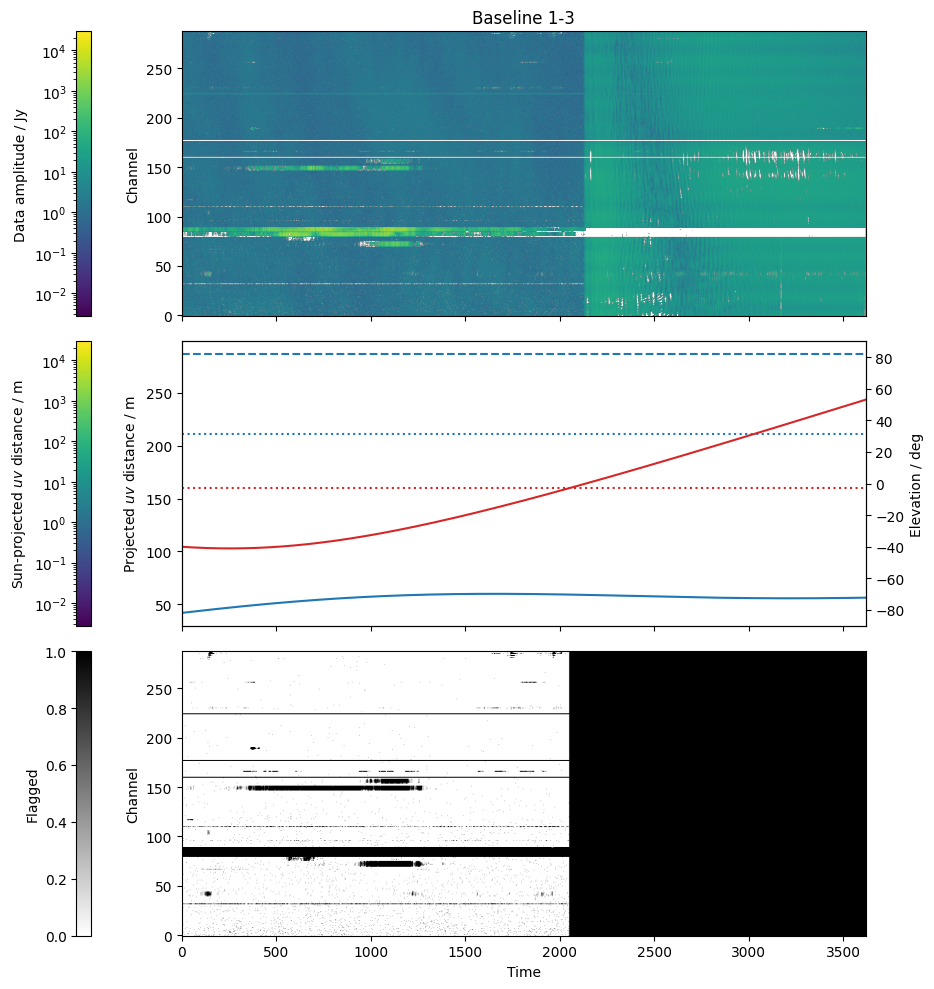

In [ ]:
def uvw_flagger(
    ms_path: Path, 
    baselines: Baselines, 
    hour_angle: HourAngle, 
    uvws: np.ndarray,
    horizon_lim: u.Quantity = -3*u.deg
):
    sun_scale = get_sun_scale_uvdist(ms_path=ms_path)
    
    print(f"{uvws.shape=}")
    print(f"{sun_scale.sun_scale_chan_lambda.min()=}")
    print(f"{sun_scale.sun_scale_chan_lambda.max()=}")
    with table(str(ms_path), readonly=True) as _tab, taql(
            "select from $_tab where ANTENNA1 != ANTENNA2"
    ) as tab:
        for idx, row in tqdm(enumerate(tab)):
            time = row["TIME"]
            t_idx = hour_angle.time_map[time]            
            if hour_angle.elevation[t_idx] < horizon_lim:
                continue
            
            ant_1 = row["ANTENNA1"]
            ant_2 = row["ANTENNA2"]
            
            assert ant_1 != ant_2

            b_idx = baselines.b_map[(ant_1, ant_2)]
            
            try:
                # uvws are (uvw, baseline, timestep)
                # uvw.shape = (3, 630, 8200)
                uvws_bt = uvws[:, b_idx, t_idx, None] / sun_scale.chan_lambda
                # uvw_bt = (uvw, channel lambda)
                # uvw_bt.shape = (3, 288)
                uv_dist = np.sqrt(
                    (uvws_bt[0]) ** 2 + 
                    (uvws_bt[1]) ** 2 
                ) 
                flag_uv_dist = uv_dist < sun_scale.sun_scale_chan_lambda.value
            except UnitConversionError as e:
                print(f"{flag_uv_dist=}")
                print(f"{sun_scale.sun_scale_chan_lambda=}")
                raise e
                
            if np.any(flag_uv_dist):
                # flag shape (chan, pol)
                put_flag = row["FLAG"] | flag_uv_dist[:, None]
                # tab.putcell(columnname="FLAG", rownr=idx, value=put_flag)
                return put_flag, ant_1, ant_2



test_flag = uvw_flagger(
    ms_path=ms_path, 
    baselines=baselines,
    hour_angle=sun_hour_angles,
    uvws=sun_uvws.reshape(sun_shape)
)    
    
    

Successful readonly open of default-locked table /Users/tho822/Documents/scienceData.EMU_1141-55.SB47138.EMU_1141-55.beam30_averaged_cal.leakage.ms/SPECTRAL_WINDOW: 14 columns, 1 rows
uvws.shape=(3, 630, 3618)
sun_scale.sun_scale_chan_lambda.min()=<Quantity 210.69596921 m>
sun_scale.sun_scale_chan_lambda.max()=<Quantity 286.28402303 m>
Successful readonly open of default-locked table /Users/tho822/Documents/scienceData.EMU_1141-55.SB47138.EMU_1141-55.beam30_averaged_cal.leakage.ms: 24 columns, 2409588 rows


72551it [02:36, 464.69it/s]


KeyboardInterrupt: 

Successful readonly open of default-locked table scienceData.EMU_1141-55.SB47138.EMU_1141-55.beam00_averaged_cal.leakage.ms/SPECTRAL_WINDOW: 14 columns, 1 rows


/tmp/ipykernel_51237/882041813.py:43: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, (ax, ax1) = plt.subplots(1,2)


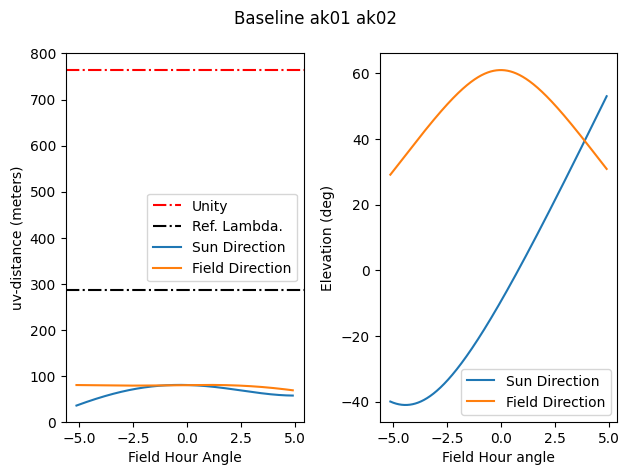

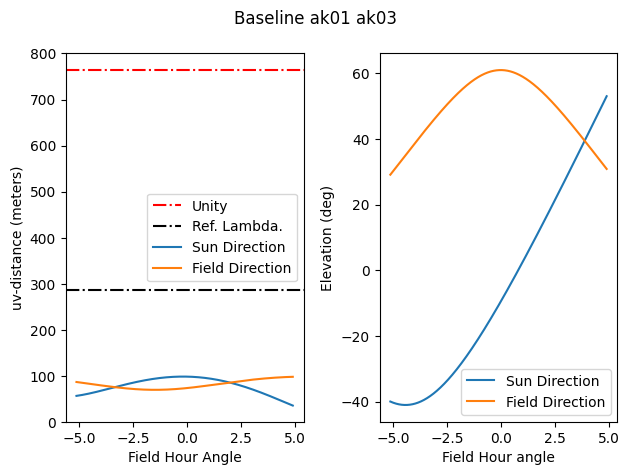

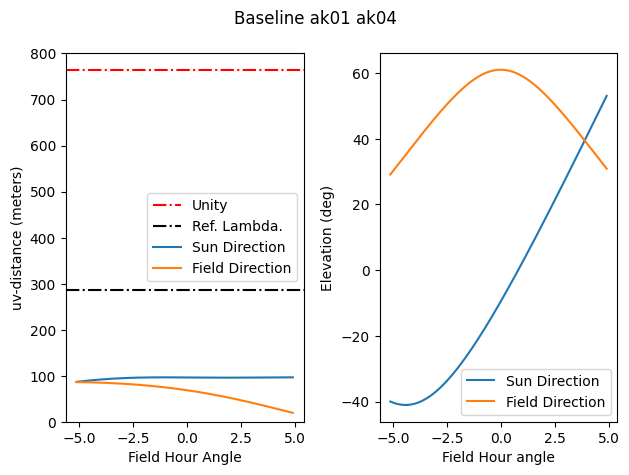

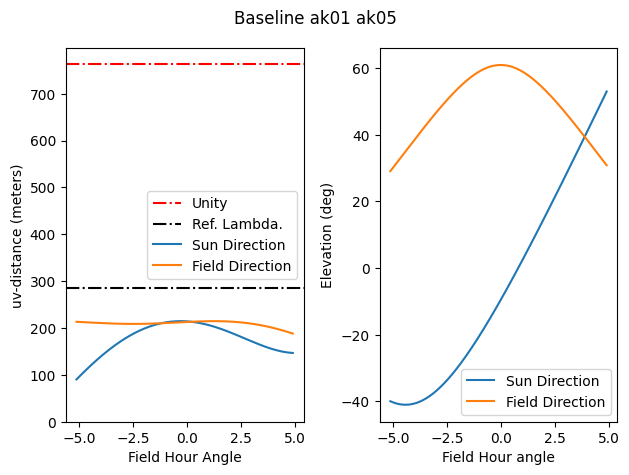

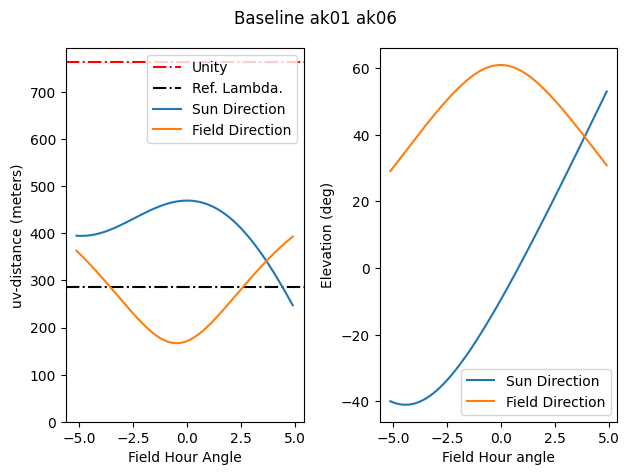

...

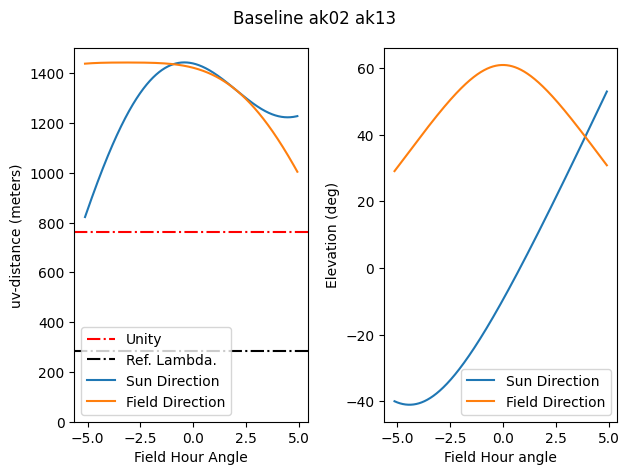

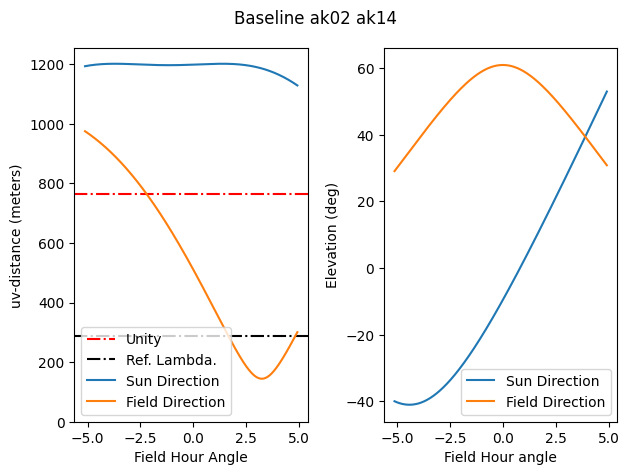

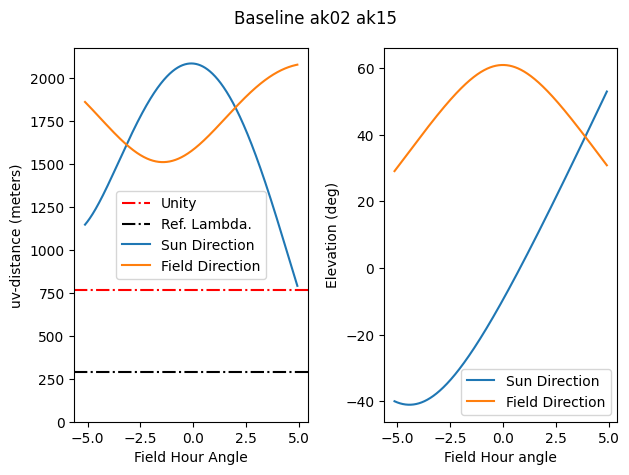

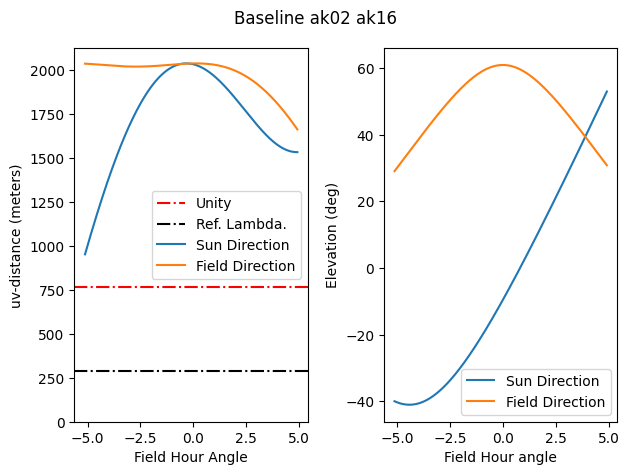

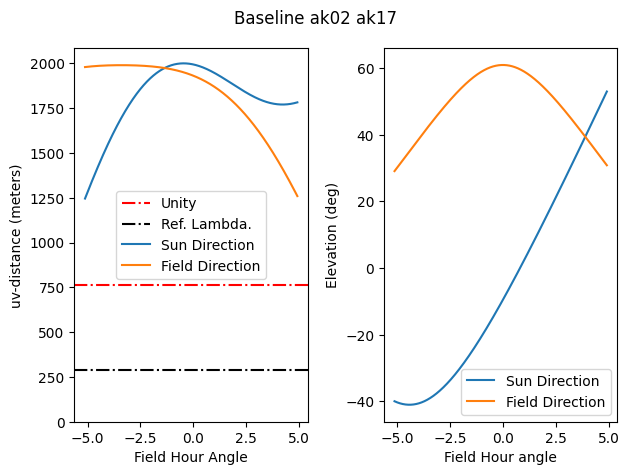

In [ ]:
@dataclass
class UVWs():
    uvw_m: np.ndarray
    uvw_l: np.ndarray
    uvw_cl: np.ndarray
    
def scale_uvws(uvws: u.m, wavelength: u.m, channel_wavelengths: u.m) -> UVWs:
    
    uvw_l = (uvws / wavelength).decompose()
    uvw_cl = (uvws[..., None] / wavelength).decompose()
    return UVWs(uvw_m=uvws, uvw_l=uvw_l, uvw_cl=uvw_cl)


def plot_baselines_and_cuts(
    ms_path: Path, 
    sun_uvws: np.ndarray,
    field_uvws: np.ndarray,
    sun_hour_angles: HourAngle,
    field_hour_angles: HourAngle,
    reshape_to: tuple[int, ...],
    plot_limit: int = 10
) -> None:

    compute_sun_scale = get_sun_scale_uvdist(ms_path=ms_path)
    sun_scale_uvws = scale_uvws(
        uvws=sun_uvws, 
        wavelength=compute_sun_scale.ref_lambda,
        channel_wavelengths=compute_sun_scale.chan_lambda
    )
    sun_uvws_l = sun_scale_uvws.uvw_l.reshape(reshape_to)

    field_scale_uvws = scale_uvws(
        uvws=field_uvws, 
        wavelength=compute_sun_scale.ref_lambda,
        channel_wavelengths=compute_sun_scale.chan_lambda
    )
    field_uvws_l = field_scale_uvws.uvw_l.reshape(reshape_to)

    for b_idx in range(plot_limit):

        ant_1, ant_2 = reverse_bl_mapping[b_idx]
        ant_1, ant_2 = int(ant_1), int(ant_2)
        fig, (ax, ax1) = plt.subplots(1,2)

        # ax.axhline(sun_scale - 1, ls=':', c='black', label="Unity")
        ax.axhline(compute_sun_scale.sun_scale_unity.decompose().value, ls='-.', c='red', label="Unity")

        ax.axhline(compute_sun_scale.sun_scale_ref_lambda.decompose().value, ls='-.', c='black', label="Ref. Lambda.")
        # ax.axvline(sun_ha_0, ls='--', c="black")
        # ax1.axvline(sun_ha_0, ls='--', c="black")

        ax.plot(
            hour_angle.hour_angle,
            np.sqrt(sun_uvws_l[0, b_idx, :]**2 + 
                    sun_uvws_l[1, b_idx, :]**2
            ),
            label="Sun Direction"
        )
        ax.plot(
            hour_angle.hour_angle,
            np.sqrt(
                field_uvws_l[0, b_idx, :]**2 + 
                field_uvws_l[1, b_idx, :]**2
            ),
            label="Field Direction"
        )
        ax.set(
            xlabel="Field Hour Angle",
            ylabel="uv-distance (meters)",
            ylim=[0.0, None]
        )
        ax.legend(prop={'size': 10})

        ax1.plot(
            field_hour_angles.hour_angle,
            sun_hour_angles.elevation,
            label="Sun Direction"
        )
        ax1.plot(
            field_hour_angles.hour_angle,
            field_hour_angles.elevation,
            label="Field Direction"
        )
        ax1.set(
            xlabel="Field Hour angle",
            ylabel="Elevation (deg)"
        )
        ax1.legend()
        fig.suptitle(f"Baseline ak{ant_1+1:02d} ak{ant_2+1:02d}")
        fig.tight_layout()
        
plot_baselines_and_cuts(
    ms_path=ms_path,
    sun_uvws=sun_uvws,
    field_uvws=ouvw,
    sun_hour_angles=sun_hour_angles,
    field_hour_angles=hour_angle,
    reshape_to=sun_shape,
    plot_limit=50
)


    

Successful readonly open of default-locked table scienceData.EMU_1141-55.SB47138.EMU_1141-55.beam00_averaged_cal.leakage.ms/SPECTRAL_WINDOW: 14 columns, 1 rows
['MEAS_FREQ_REF', 'CHAN_FREQ', 'REF_FREQUENCY', 'CHAN_WIDTH', 'EFFECTIVE_BW', 'RESOLUTION', 'FLAG_ROW', 'FREQ_GROUP', 'FREQ_GROUP_NAME', 'IF_CONV_CHAIN', 'NAME', 'NET_SIDEBAND', 'NUM_CHAN', 'TOTAL_BANDWIDTH']
ref_nu=<Quantity [7.99990741e+08] Hz>
ref_lambda=<Quantity [0.37474491] m>
sun_scale=np.float64(114.59155902616465)
Successful readonly open of default-locked table scienceData.EMU_1141-55.SB47138.EMU_1141-55.beam00_averaged_cal.leakage.ms/SPECTRAL_WINDOW: 14 columns, 1 rows


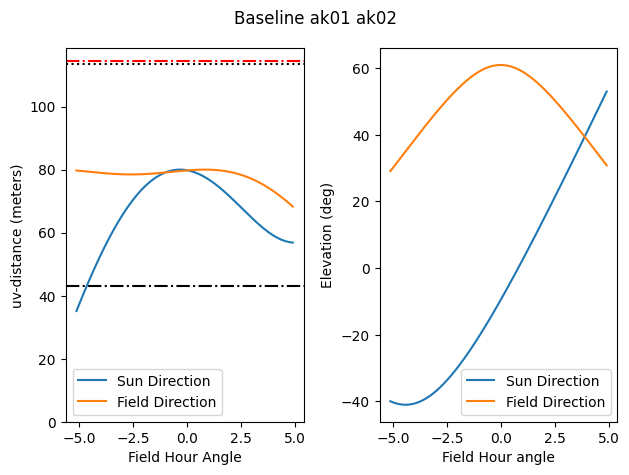

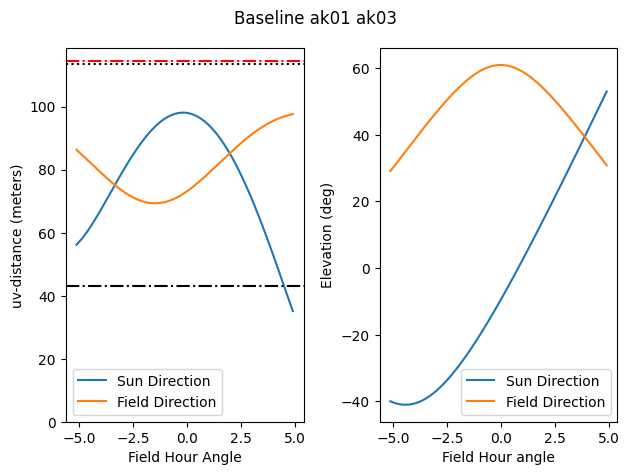

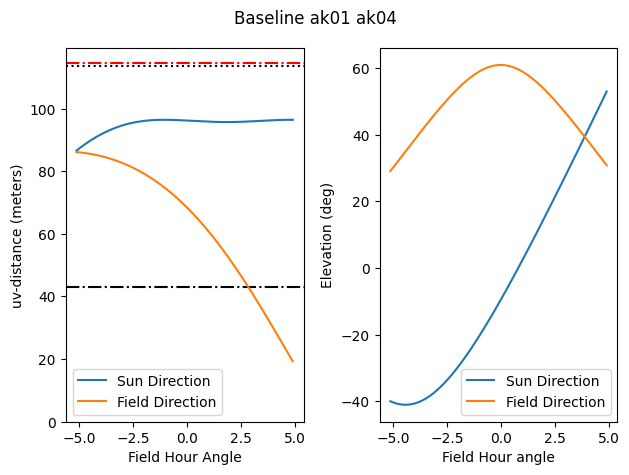

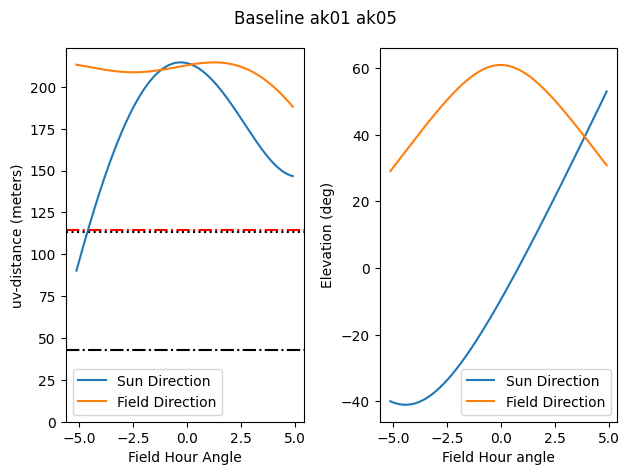

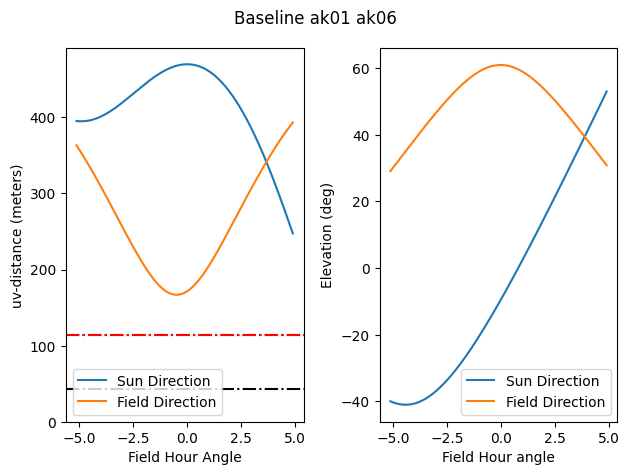

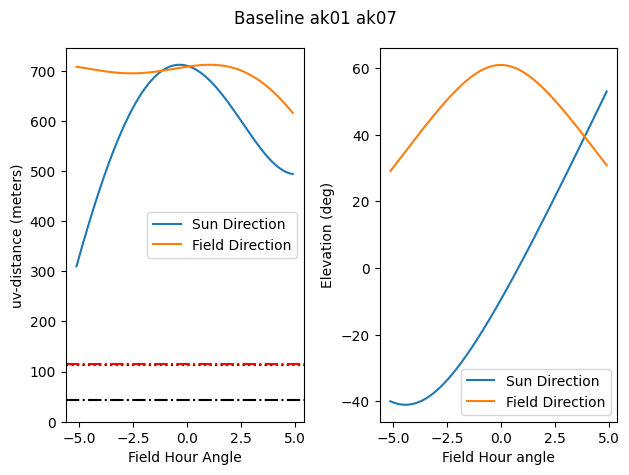

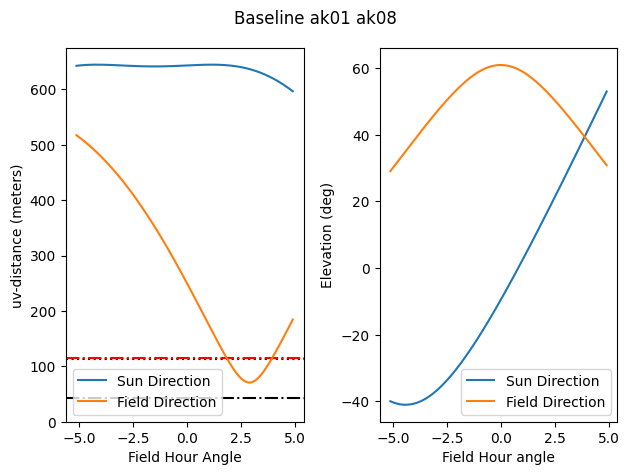

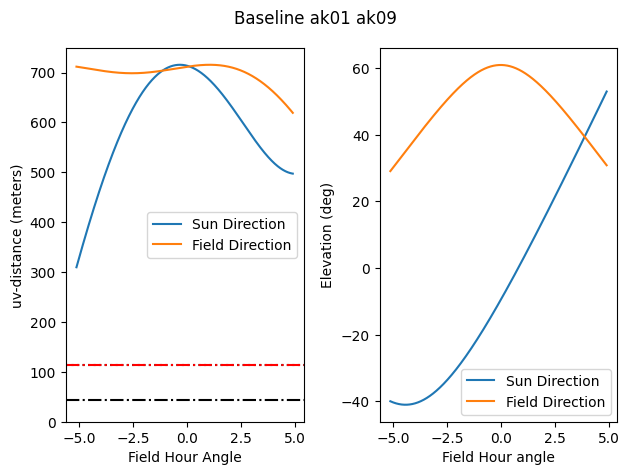

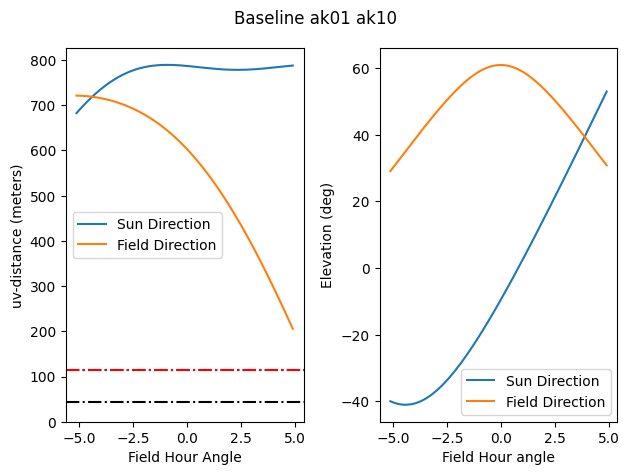

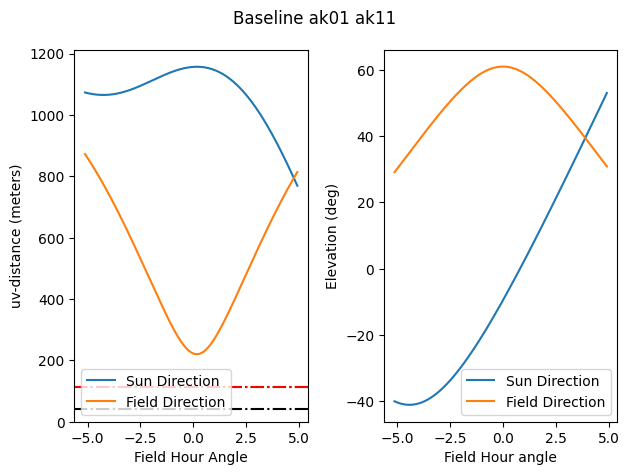

In [ ]:

plt.close('all')

from astropy.constants import c

with table(str(ms_path / "SPECTRAL_WINDOW")) as tab:
    print(tab.colnames())
    ref_nu = tab.getcol('REF_FREQUENCY')
    ref_nu = ref_nu*u.Hz
    ref_lambda = (c / ref_nu).decompose()

print(f"{ref_nu=}")
print(f"{ref_lambda=}")
sun_diameter = 0.5*u.deg

sun_scale = ((1*u.m) / sun_diameter).decompose().value
print(f"{sun_scale=}")

reverse_bl_mapping = {v: k for k, v in baselines.b_map.items()}
b_idx = 0

sun_min_ha = np.argmin(np.abs(sun_hour_angles.elevation))
sun_ha_0 = hour_angle.hour_angle[sun_min_ha].value

ref_sun_uvws = sun_uvws / ref_lambda 
ref_ouvw = ouvw / ref_lambda 

compute_sun_scale = get_sun_scale_uvdist(ms_path=ms_path)

for b_idx in range(10):

    ant_1, ant_2 = reverse_bl_mapping[b_idx]
    ant_1, ant_2 = int(ant_1), int(ant_2)
    fig, (ax, ax1) = plt.subplots(1,2)

    ax.axhline(sun_scale - 1, ls=':', c='black')
    ax.axhline(compute_sun_scale.sun_scale_unity.decompose().value, ls='-.', c='red')

    ax.axhline(compute_sun_scale.sun_scale_ref_lambda.decompose().value, ls='-.', c='black')
    # ax.axvline(sun_ha_0, ls='--', c="black")
    # ax1.axvline(sun_ha_0, ls='--', c="black")

    ax.plot(
        hour_angle.hour_angle,
        np.sqrt(ref_sun_uvws.reshape(sun_shape)[0, b_idx, :]**2 + 
                ref_sun_uvws.reshape(sun_shape)[1, b_idx, :]**2
        ),
        label="Sun Direction"
    )
    ax.plot(
        hour_angle.hour_angle,
        np.sqrt(
            ref_ouvw.reshape(sun_shape)[0, b_idx, :]**2 + 
            ref_ouvw.reshape(sun_shape)[1, b_idx, :]**2
        ),
        label="Field Direction"
    )
    ax.set(
        xlabel="Field Hour Angle",
        ylabel="uv-distance (meters)",
        ylim=[0.0, None]
    )
    ax.legend()

    ax1.plot(
        hour_angle.hour_angle,
        sun_hour_angles.elevation,
        label="Sun Direction"
    )
    ax1.plot(
        hour_angle.hour_angle,
        hour_angle.elevation,
        label="Field Direction"
    )
    ax1.set(
        xlabel="Field Hour angle",
        ylabel="Elevation (deg)"
    )
    ax1.legend()
    fig.suptitle(f"Baseline ak{ant_1+1:02d} ak{ant_2+1:02d}")
    fig.tight_layout()

